# Multimedia Project --
## Retrieving Frames

In [1]:
from perceptual.filterbank import *

import cv2
import numpy as np
import pandas as pd
import colorsys
import matplotlib.pyplot as plt

# determine what OpenCV version we are using
try:
    import cv2.cv as cv
    USE_CV2 = True
except ImportError:
    # OpenCV 3.x does not have cv2.cv submodule
    USE_CV2 = False
    
import sys
from skimage import color
from skimage import io
from cvtools import ipynb_show_cv2_image
from cvtools import ipynb_show_matrix


In [2]:
def yiq_to_rgb_new(y, i, q):
    r = y + 0.948262*i + 0.624013*q
    g = y - 0.276066*i - 0.639810*q
    b = y - 1.105450*i + 1.729860*q

    return (r, g, b)

In [3]:
# vidFname = 'nba.mp4'

# print(cv2.__version__)
# vidReader = cv2.VideoCapture(vidFname)
# vidFrames = int(vidReader.get(cv2.CAP_PROP_FRAME_COUNT))
# #49485 = 35* 23* 60
# success,image = vidReader.read()
# #(480, 852, 3)
# count = 0
# success = True
# while success:
#     # Extracting every 20 frames
#     for i in range(20):
#         success,image = vidReader.read()
#     cv2.imwrite("frames/frame%d.jpg" % count, image)     # save frame as JPEG file
#     success,image = vidReader.read()
#     #print('Read a new frame: ', success)
#     count += 1
    

3.2.0


KeyboardInterrupt: 

(480, 852, 3)
(480, 852, 3)


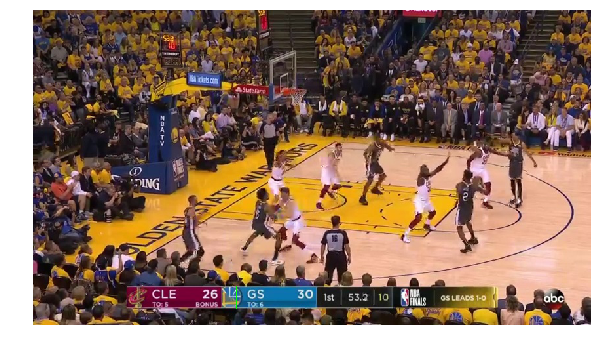

In [4]:
from cvtools import ipynb_show_cv2_image
from cvtools import ipynb_show_matrix

image = cv2.imread('frames/frame0.jpg')
print(np.shape(image))

image_modified = image.copy()
print(np.shape(image_modified))

cv2.rectangle(image_modified, (160, 420), (285, 455), (0, 0, 255))
cv2.rectangle(image_modified, (310, 420), (430, 455), (0, 255, 0))
plt.clf()
ipynb_show_cv2_image(image_modified, figsize=(10, 10))  
plt.show()


In [5]:
def crop_img(image_modified):
    cropRedImg = image_modified[424:444,258:284]
    cropBlueImg = image_modified[424:444,400:429]
    ipynb_show_cv2_image(cropRedImg, figsize=(5, 5)) 
    ipynb_show_cv2_image(cropBlueImg, figsize=(5, 5)) 
    return cropRedImg,cropBlueImg

In [6]:
image1 = cv2.imread('frames/frame2.jpg')
image2 = cv2.imread('frames/frame57.jpg')

red0,blue0 = crop_img(image_modified)
red1,blue1 = crop_img(image1)
red2,blue2 = crop_img(image2)

red100,blue100 = crop_img(cv2.imread('frames/frame251.jpg'))

In [ ]:
from scipy.spatial.distance import euclidean
from scipy.spatial.distance import pdist

channel_index=0

error = np.abs(
        red0[:,:,channel_index] - red1[:,:,channel_index])

title = 'error in channel #%d (min: %d, avg: %.1f, max: %d)' % (
    channel_index,np.min(error), np.average(error), np.max(error))
print(title)
ipynb_show_matrix(error, title)

error = np.abs(
        red0[:,:,channel_index] - red2[:,:,channel_index])

title = 'error in channel #%d (min: %d, avg: %.1f, max: %d)' % (
    channel_index,np.min(error), np.average(error), np.max(error))
print(title)
ipynb_show_matrix(error, title)

error = np.abs(
        red100[:,:,channel_index] - red0[:,:,channel_index])

title = 'error in channel #%d (min: %d, avg: %.1f, max: %d)' % (
    channel_index,np.min(error), np.average(error), np.max(error))
print(title)
ipynb_show_matrix(error, title)

######@# blue
print("blue:")
error = np.abs(
        blue0[:,:,channel_index] - blue1[:,:,channel_index])

title = 'error in channel #%d (min: %d, avg: %.1f, max: %d)' % (
    channel_index,np.min(error), np.average(error), np.max(error))
print(title)
ipynb_show_matrix(error, title)

error = np.abs(
        blue0[:,:,channel_index] - blue2[:,:,channel_index])

title = 'error in channel #%d (min: %d, avg: %.1f, max: %d)' % (
    channel_index,np.min(error), np.average(error), np.max(error))
print(title)
ipynb_show_matrix(error, title)

error = np.abs(
        blue100[:,:,channel_index] - blue0[:,:,channel_index])

title = 'error in channel #%d (min: %d, avg: %.1f, max: %d)' % (
    channel_index,np.min(error), np.average(error), np.max(error))
print(title)


### New

In [7]:
def crop_img_to_grey(image_modified):
    cropRedImg = image_modified[424:444,258:284]
    cropBlueImg = image_modified[424:444,400:429]
#     ipynb_show_cv2_image(cropRedImg, figsize=(5, 5)) 
#     ipynb_show_cv2_image(cropBlueImg, figsize=(5, 5)) 
    Img_Red = color.rgb2gray(cropRedImg)
    Img_Blue = color.rgb2gray(cropBlueImg)
    return Img_Red,Img_Blue

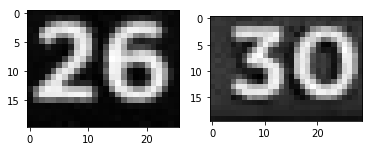

In [9]:
image1 = cv2.imread('frames/frame2.jpg')
red0,blue0 = crop_img_to_grey(image1)
plt.clf()
plt.subplot(1, 2, 1)
plt.imshow(red0,cmap = 'gray')
plt.subplot(1, 2, 2)
plt.imshow(blue0,cmap='gray')
plt.show()

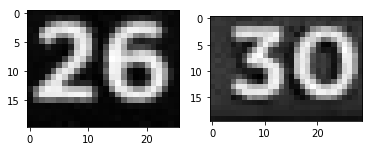

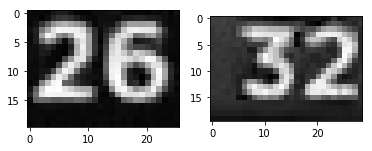

In [10]:
image1 = cv2.imread('frames/frame2.jpg')
image2 = cv2.imread('frames/frame12.jpg')

# red0,blue0 = crop_img_to_grey(image_modified)
red1,blue1 = crop_img_to_grey(image1)
red2,blue2 = crop_img_to_grey(image2)
# plt.figure()
# plt.clf()
# plt.subplot(1, 2, 1)
# plt.imshow(red0,cmap = 'gray')
# plt.subplot(1, 2, 2)
# plt.imshow(blue0,cmap='gray')
# plt.show()

plt.figure()
plt.clf()
plt.subplot(1, 2, 1)
plt.imshow(red1,cmap = 'gray')
plt.subplot(1, 2, 2)
plt.imshow(blue1,cmap='gray')
plt.show()

plt.figure()
plt.clf()
plt.subplot(1, 2, 1)
plt.imshow(red2,cmap = 'gray')
plt.subplot(1, 2, 2)
plt.imshow(blue2,cmap='gray')
plt.show()



# red100,blue100 = crop_img(cv2.imread('frames/frame251.jpg'))

In [11]:
A = np.array([[1,2,3],[2,1,3]])
B = np.array([[1,1,1],[1,1,1]])
np.sqrt(np.sum(np.square(A-B)))

3.1622776601683795

In [12]:
#abs test
from scipy.spatial.distance import euclidean
from scipy.spatial.distance import pdist
goal = []
prev = 0
curr = 1
for i in np.arange(3,40):
    if prev == 0:
        prev = i-1
        curr = i
#     image1 = cv2.imread('frames/frame'+str(prev)+'.jpg')
#     image2 = cv2.imread('frames/frame'+str(curr)+'.jpg')
    image1 = cv2.imread('frames/frame'+str(i-1)+'.jpg')
    image2 = cv2.imread('frames/frame'+str(i)+'.jpg')
    red0,blue0 = crop_img_to_grey(image1)
    red1,blue1 = crop_img_to_grey(image2)
# red2,blue2 = crop_img_to_grey(image2)

#     error_Red01 = np.sqrt(np.sum(np.square(red0-red1)))
#     error_Blue01 = np.sqrt(np.sum(np.square(blue0-blue1)))
    error_Red01 = np.sum(np.abs(red0-red1))
    error_Blue01 = np.sum(np.abs(blue0-blue1))
    print('error in grayscale: Red:%.3f , Blue:%.3f'%(error_Red01,error_Blue01))
    if ( (50< error_Red01 < 130) or (50<  error_Blue01 < 130) ) and ((error_Red01 > 50.0 and error_Blue01 > 50.0)==0):
        prev = i
        curr +=1
        goal.append(i)
        
    else:
        curr+=1

print(goal)




error in grayscale: Red:3.511 , Blue:5.141
error in grayscale: Red:13.596 , Blue:13.943
error in grayscale: Red:4.889 , Blue:6.193
error in grayscale: Red:2.812 , Blue:3.521
error in grayscale: Red:4.336 , Blue:3.833
error in grayscale: Red:12.788 , Blue:13.626
error in grayscale: Red:2.096 , Blue:3.026
error in grayscale: Red:3.558 , Blue:2.617
error in grayscale: Red:4.172 , Blue:19.092
error in grayscale: Red:14.378 , Blue:66.548
error in grayscale: Red:6.073 , Blue:7.844
error in grayscale: Red:5.509 , Blue:7.702
error in grayscale: Red:5.482 , Blue:5.680
error in grayscale: Red:5.844 , Blue:6.629
error in grayscale: Red:16.759 , Blue:15.403
error in grayscale: Red:5.759 , Blue:4.994
error in grayscale: Red:5.166 , Blue:5.954
error in grayscale: Red:4.509 , Blue:4.834
error in grayscale: Red:14.119 , Blue:15.227
error in grayscale: Red:4.905 , Blue:5.431
error in grayscale: Red:6.167 , Blue:7.020
error in grayscale: Red:2.558 , Blue:5.149
error in grayscale: Red:14.658 , Blue:14.46

In [13]:
#abs test
# read vedio and process the img at the same time
# Simple dissimilarity is applied here image-image (pixel by pixel)

vidFname = 'nba.mp4'

vidReader = cv2.VideoCapture(vidFname)
vidFrames = int(vidReader.get(cv2.CAP_PROP_FRAME_COUNT))
#49485 = 35* 23* 60
success,image = vidReader.read()
#(480, 852, 3)

red0,blue0 = crop_img_to_grey(image)

# ipynb_show_cv2_image(red0, figsize=(5, 5)) 
# ipynb_show_cv2_image(blue0, figsize=(5, 5)) 
images_red = {}
images_blue = {}
errors_red = {}
errors_blue = {}
highlight = []
count = 0
while success:
    # Extracting every 20 frames

    for i in range(40):
        success,image = vidReader.read()
    
    success,image = vidReader.read()
    
    #print('Read a new frame: ', success)
    count += 1
    
    if success == False:
        print("break")
        break
    red1,blue1 = crop_img_to_grey(image)
    
    error_Red01 = np.sum(np.abs(red0-red1))
    error_Blue01 = np.sum(np.abs(blue0-blue1))
#     if ((error_Red01 > 3.0 and error_Red01 < 15 ) or ( error_Blue01 > 3.0 and error_Blue01 < 15)) and ((error_Red01 > 3.0 and error_Blue01 > 3.0)==0):
    if ( (50< error_Red01 < 130) or (50<  error_Blue01 < 130) ) and ((error_Red01 > 50.0 and error_Blue01 > 50.0)==0):
        red0 = red1
        blue0 = blue1
        highlight.append(count)
        images_red[count] = red1
        images_blue[count] = blue1
        errors_red[count] = error_Red01
        errors_blue[count] = error_Blue01
        
print("done")
print(len(highlight))
print(highlight)

break
done
31
[7, 188, 229, 264, 320, 412, 482, 521, 552, 553, 576, 577, 596, 604, 634, 722, 723, 740, 784, 829, 918, 931, 932, 948, 958, 959, 998, 999, 1036, 1037, 1097]


7 14.715996078431374 63.7036505882353


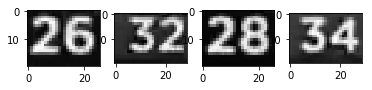

188 31.294607843137257 65.50635647058824


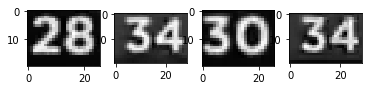

229 91.0223831372549 19.484497254901964


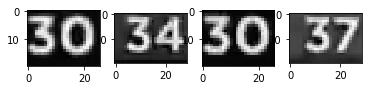

264 17.467081176470586 66.04632078431372


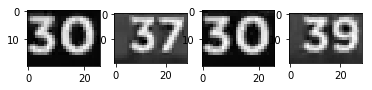

320 12.666154901960782 53.53576313725491


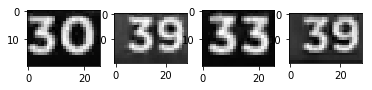

412 91.89689019607843 19.675307843137258


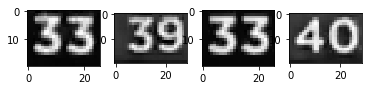

482 15.767293333333335 69.7216843137255


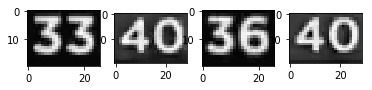

521 53.99364745098039 20.727272941176473


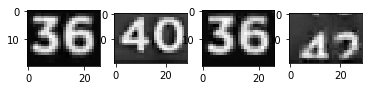

552 15.24512117647059 96.64406274509804


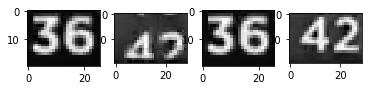

553 7.312545490196079 87.27136235294117


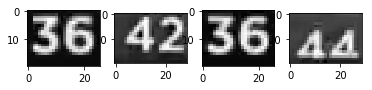

576 13.054576078431372 85.96628470588236


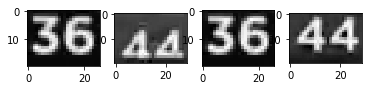

577 4.050876470588236 80.34163450980392


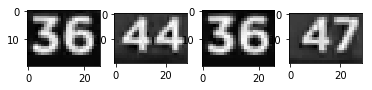

596 12.170870588235294 69.42830509803922


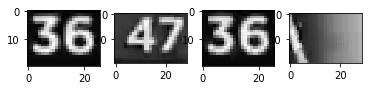

604 13.650863529411769 121.74869921568627


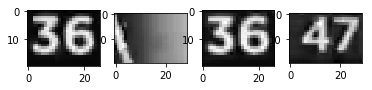

634 17.56220431372549 122.9464243137255


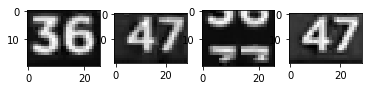

722 113.74903490196078 17.04135294117647


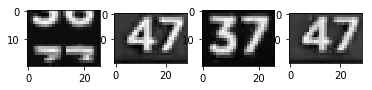

723 103.04524274509804 11.990814509803922


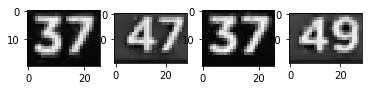

740 14.771249411764703 55.40894705882353


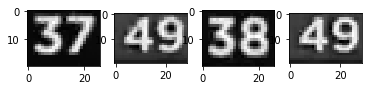

784 87.83871137254903 15.672996470588236


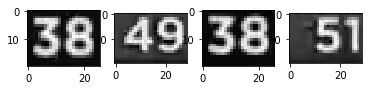

829 43.18236705882353 76.15745960784315


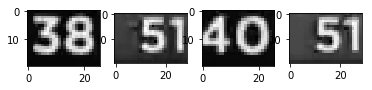

918 101.25962156862745 13.969688235294118


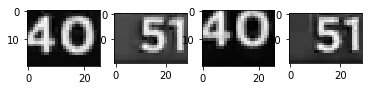

931 103.04371529411765 12.228537647058825


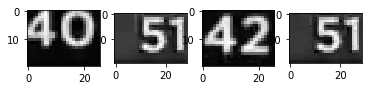

932 129.23636470588235 4.517150196078428


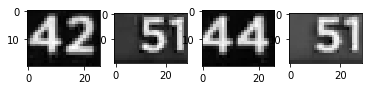

948 95.8514850980392 11.903100000000002


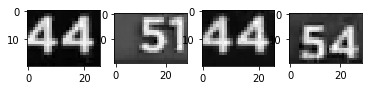

958 13.164696078431374 93.04992431372548


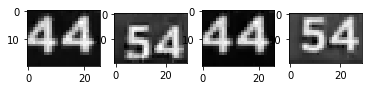

959 7.919974509803923 86.04429294117648


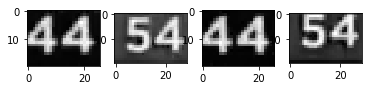

998 12.64736980392157 65.84982


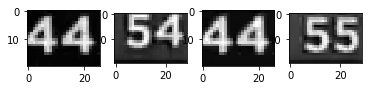

999 11.385489019607842 78.52454039215687


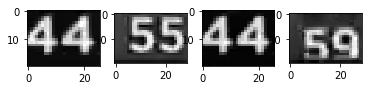

1036 12.014166666666666 75.22702196078431


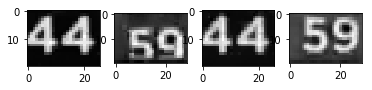

1037 13.112298039215688 83.97225098039215


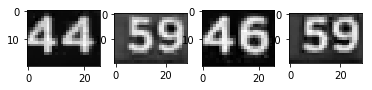

IndexError: list index out of range

In [60]:
for i in np.arange(0,len(highlight)):
    red1 = images_red[highlight[i]]
    blue1 = images_blue[highlight[i]]
    red2 = images_red[highlight[i+1]]
    blue2 = images_blue[highlight[i+1]]
    print(highlight[i],errors_red[highlight[i]],errors_blue[highlight[i]])
    plt.figure()
    plt.clf()
    plt.subplot(1, 4, 1)
    plt.imshow(red1,cmap = 'gray')
    plt.subplot(1, 4, 2)
    plt.imshow(blue1,cmap='gray')
    plt.subplot(1, 4, 3)
    plt.imshow(red2,cmap = 'gray')
    plt.subplot(1, 4, 4)
    plt.imshow(blue2,cmap='gray')
    plt.show()

In [51]:
#euclidian
from scipy.spatial.distance import euclidean
from scipy.spatial.distance import pdist
goal = []
prev = 0
curr = 1
for i in np.arange(3,40):
    if prev == 0:
        prev = i-1
        curr = i
    image1 = cv2.imread('frames/frame'+str(prev)+'.jpg')
    image2 = cv2.imread('frames/frame'+str(curr)+'.jpg')
#     print('i:%d'%i)
    red0,blue0 = crop_img_to_grey(image1)
    red1,blue1 = crop_img_to_grey(image2)
# red2,blue2 = crop_img_to_grey(image2)

    error_Red01 = np.sqrt(np.sum(np.square(red0-red1)))
    error_Blue01 = np.sqrt(np.sum(np.square(blue0-blue1)))
    print('error in grayscale: Red:%.3f , Blue:%.3f'%(error_Red01,error_Blue01))
    if (error_Red01 > 3.0 and error_Red01 < 15 ) or ( error_Blue01 > 3.0 and error_Blue01 < 15) and ((error_Red01 > 3.0 and error_Blue01 > 3.0)==0):
        prev = i
        curr +=1
        goal.append(i)
        
    else:
        curr+=1

print(goal)



error in grayscale: Red:0.200 , Blue:0.267
error in grayscale: Red:0.808 , Blue:0.783
error in grayscale: Red:0.809 , Blue:0.792
error in grayscale: Red:0.808 , Blue:0.782
error in grayscale: Red:0.804 , Blue:0.768
error in grayscale: Red:0.805 , Blue:0.773
error in grayscale: Red:0.802 , Blue:0.759
error in grayscale: Red:0.772 , Blue:0.739
error in grayscale: Red:0.780 , Blue:1.429
error in grayscale: Red:0.950 , Blue:4.239
error in grayscale: Red:0.399 , Blue:0.576
error in grayscale: Red:0.535 , Blue:0.653
error in grayscale: Red:0.628 , Blue:0.672
error in grayscale: Red:0.613 , Blue:0.768
error in grayscale: Red:0.924 , Blue:1.044
error in grayscale: Red:0.932 , Blue:1.069
error in grayscale: Red:0.843 , Blue:1.074
error in grayscale: Red:0.863 , Blue:1.122
error in grayscale: Red:0.878 , Blue:1.017
error in grayscale: Red:0.857 , Blue:0.970
error in grayscale: Red:0.868 , Blue:0.978
error in grayscale: Red:0.872 , Blue:0.929
error in grayscale: Red:0.936 , Blue:0.901
error in gr

In [43]:
# read vedio and process the img at the same time
# Simple dissimilarity is applied here image-image (pixel by pixel)

vidFname = 'nba.mp4'

vidReader = cv2.VideoCapture(vidFname)
vidFrames = int(vidReader.get(cv2.CAP_PROP_FRAME_COUNT))
#49485 = 35* 23* 60
success,image = vidReader.read()
#(480, 852, 3)

red0,blue0 = crop_img_to_grey(image)

# ipynb_show_cv2_image(red0, figsize=(5, 5)) 
# ipynb_show_cv2_image(blue0, figsize=(5, 5)) 
images_red = {}
images_blue = {}
errors_red = {}
errors_blue = {}
highlight = []
count = 0
while success:
    # Extracting every 20 frames

    for i in range(35):
        success,image = vidReader.read()
    
    success,image = vidReader.read()
    
    #print('Read a new frame: ', success)
    count += 1
    
    if success == False:
        print("break")
        break
    red1,blue1 = crop_img_to_grey(image)
    
    error_Red01 = np.sqrt(np.sum(np.square(red0-red1)))
    error_Blue01 = np.sqrt(np.sum(np.square(blue0-blue1)))
#     if ((error_Red01 > 3.0 and error_Red01 < 15 ) or ( error_Blue01 > 3.0 and error_Blue01 < 15)) and ((error_Red01 > 3.0 and error_Blue01 > 3.0)==0):
    if ( (3< error_Red01 < 10) or (3<  error_Blue01 < 10) ) and ((error_Red01 > 3.0 and error_Blue01 > 3.0)==0):
        red0 = red1
        blue0 = blue1
        highlight.append(count)
        images_red[count] = red1
        images_blue[count] = blue1
        errors_red[count] = error_Red01
        errors_blue[count] = error_Blue01
        
print("done")
print(len(highlight))
print(highlight)

break
done
25
[7, 8, 214, 261, 300, 364, 365, 468, 469, 510, 512, 513, 515, 518, 526, 862, 863, 866, 867, 868, 869, 871, 970, 1002, 1330]


0.9379934463701199 4.838507121546668


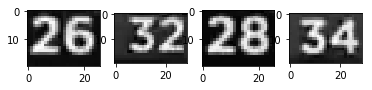

2.409440798342802 4.526554217087302


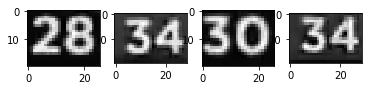

6.4076197859176265 1.940480620705946


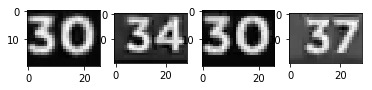

1.1117453876994376 4.428373204583898


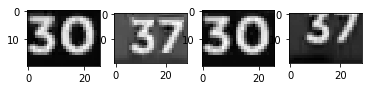

0.7802720263790776 5.087439327168176


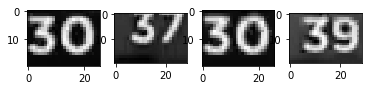

1.0781632499298377 5.594193312369169


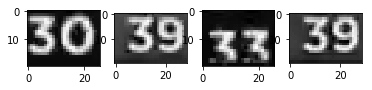

7.899970893853954 0.9955934991573224


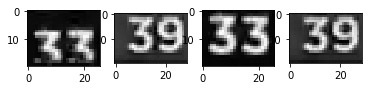

6.9012702911308 0.3360475185561115


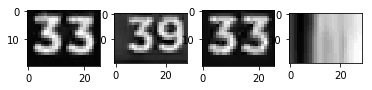

1.399183788660038 5.009388499742775


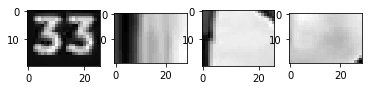

8.914246115292878 2.2738384084069465


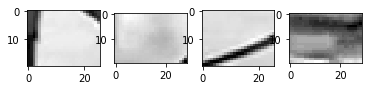

6.079596773498174 2.4133036131907333


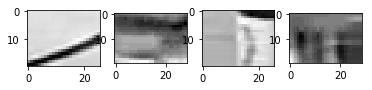

6.088404055953651 1.612088315908009


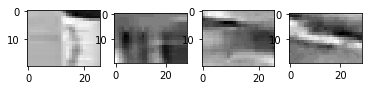

3.9828857126382466 1.357238424640366


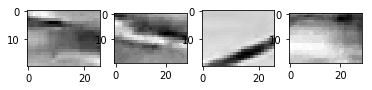

3.5149545973831877 2.437754002966084


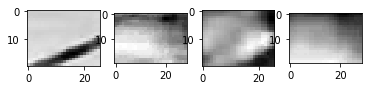

5.279600123200456 2.981132579403598


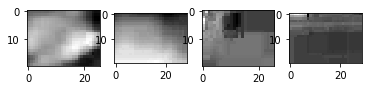

3.0344544807538827 2.4612602537170534


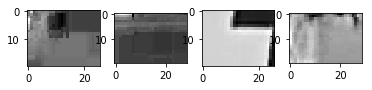

4.193677032008142 0.4625627274814261


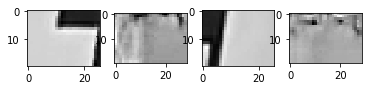

6.165777417434644 0.7510678269057963


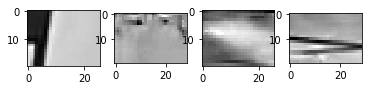

6.425975466702663 2.588221402789549


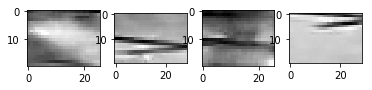

2.7798375817869765 3.7104972110972714


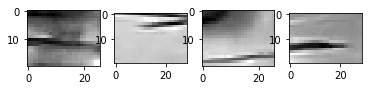

1.5739229250499192 3.4583811556818373


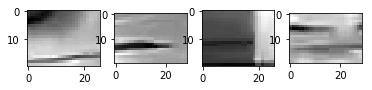

6.156931562885924 2.36232495506048


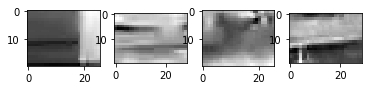

5.906393018500619 2.1310359507755576


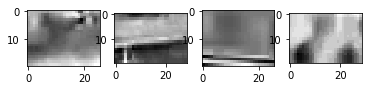

IndexError: list index out of range

In [45]:
for i in np.arange(1,len(highlight)):
    red1 = images_red[highlight[i]]
    blue1 = images_blue[highlight[i]]
    red2 = images_red[highlight[i+1]]
    blue2 = images_blue[highlight[i+1]]
    print(errors_red[highlight[i]],errors_blue[highlight[i]])
    plt.figure()
    plt.clf()
    plt.subplot(1, 4, 1)
    plt.imshow(red1,cmap = 'gray')
    plt.subplot(1, 4, 2)
    plt.imshow(blue1,cmap='gray')
    plt.subplot(1, 4, 3)
    plt.imshow(red2,cmap = 'gray')
    plt.subplot(1, 4, 4)
    plt.imshow(blue2,cmap='gray')
    plt.show()

In [28]:
# def crop_img(image_modified):
#     cropRedImg = image_modified[424:444,258:284]
#     cropBlueImg = image_modified[424:444,400:429]
# #     ipynb_show_cv2_image(cropRedImg, figsize=(5, 5)) 
# #     ipynb_show_cv2_image(cropBlueImg, figsize=(5, 5)) 
#     return cropRedImg,cropBlueImg

/Users/lizy/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


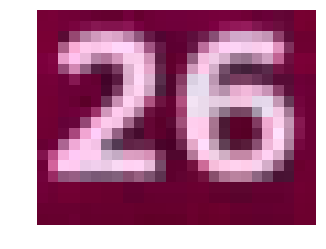

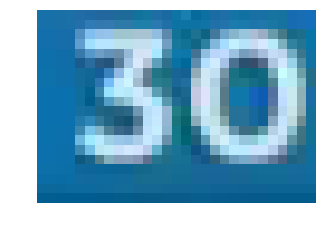

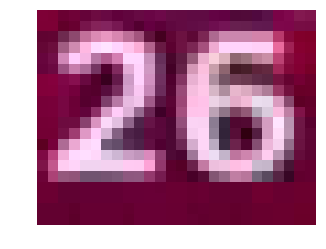

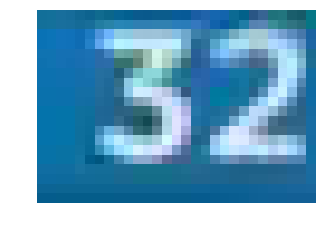

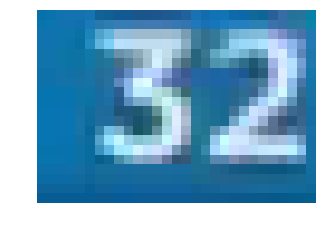

...

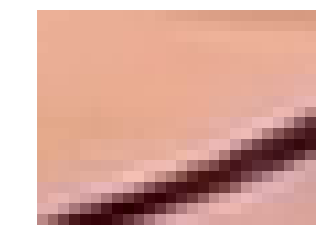

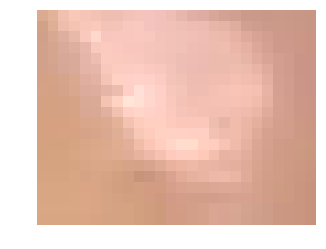

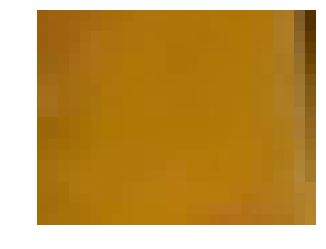

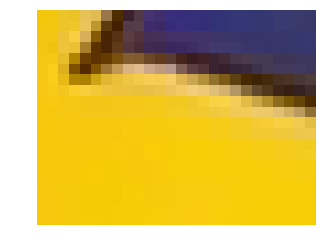

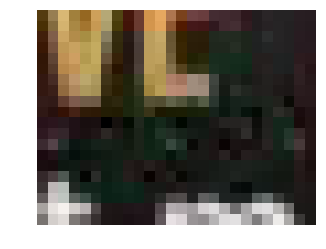

In [119]:
# read vedio and process the img at the same time
# Simple dissimilarity is applied here image-image (pixel by pixel)

vidFname = 'nba.mp4'

vidReader = cv2.VideoCapture(vidFname)
vidFrames = int(vidReader.get(cv2.CAP_PROP_FRAME_COUNT))
#49485 = 35* 23* 60
success,image = vidReader.read()
#(480, 852, 3)

red0,blue0 = crop_img(image)
ipynb_show_cv2_image(red0, figsize=(5, 5)) 
ipynb_show_cv2_image(blue0, figsize=(5, 5)) 

hightlight = []
count = 0
while success:
    # Extracting every 20 frames

    for i in range(20):
        success,image = vidReader.read()
    
    success,image = vidReader.read()
    
    #print('Read a new frame: ', success)
    count += 1
    
    if success == False:
        break
    red1,blue1 = crop_img(image)
    
#     ipynb_show_cv2_image(red1, figsize=(5, 5)) 
#     ipynb_show_cv2_image(blue1, figsize=(5, 5)) 
    
    avg_red = np.average(np.abs(
            red0[:,:,0] - red1[:,:,0]))
    avg_blue = np.average(np.abs(
            blue0[:,:,1] - blue1[:,:,1]))
    #print('err_r: %d, err_b: %d' %(avg_red,avg_blue))
    
#     if (avg_red>= 130 and avg_red < 150):
#         hightlight.append(count)
#         red0,_ = crop_img(image)
#         ipynb_show_cv2_image(red0, figsize=(5, 5)) 
#     if (avg_blue>120 and avg_blue<125):
#         if not count in(hightlight):
#             hightlight.append(count)
#         _,blue0 = crop_img(image)
#         ipynb_show_cv2_image(blue0, figsize=(5, 5)) 

In [120]:
print(len(hightlight))
print(hightlight)

47
[14, 15, 35, 43, 48, 69, 78, 83, 87, 90, 116, 176, 210, 212, 227, 236, 239, 246, 278, 323, 337, 340, 365, 369, 433, 434, 448, 450, 532, 586, 588, 663, 664, 673, 674, 691, 839, 843, 882, 883, 885, 891, 905, 977, 983, 989, 997]


In [79]:
print(avg_red,avg_blue)
print(diff_r,diff_b)

116.56309523809524 101.34777777777778
71.4047619047619 44.473333333333336


14
15
35
43
48
69
78
83
87
90
116
176
210
212
227
236
239
246
278
323
337
340
365
369
433


/Users/lizy/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


434
448
450
532
586
588
663
664
673
674
691
839
843
882
883
885
891
905
977
983
989
997


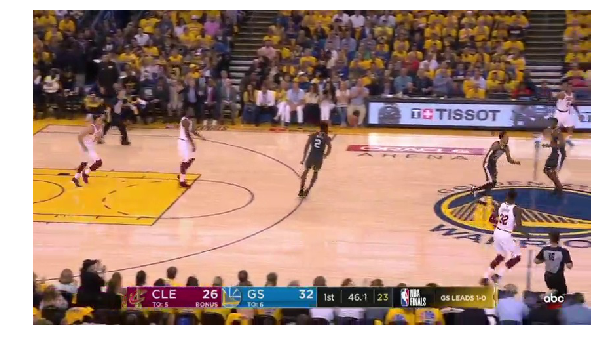

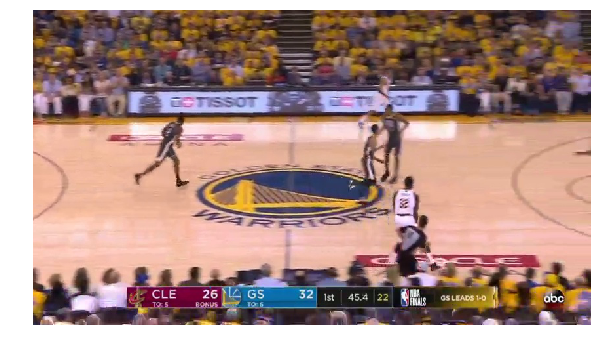

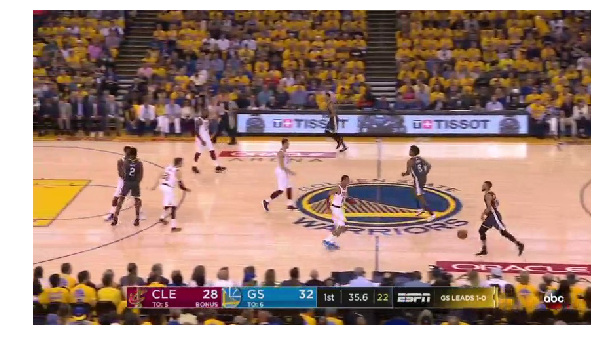

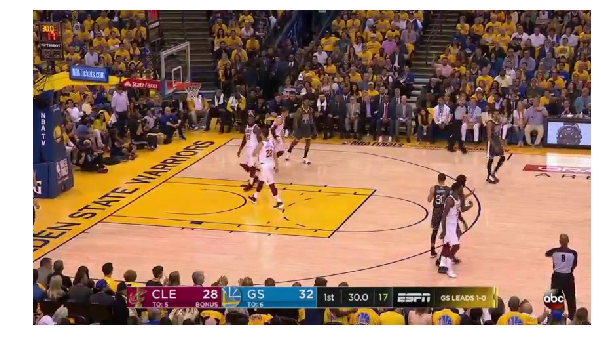

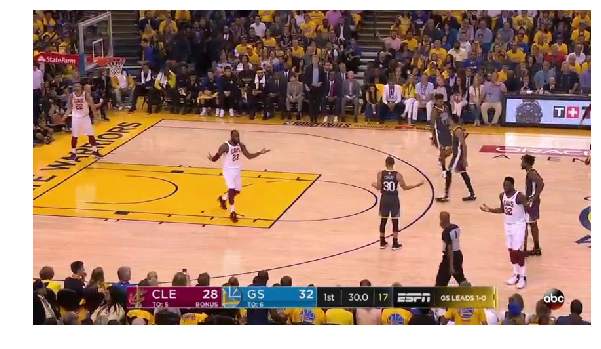

...

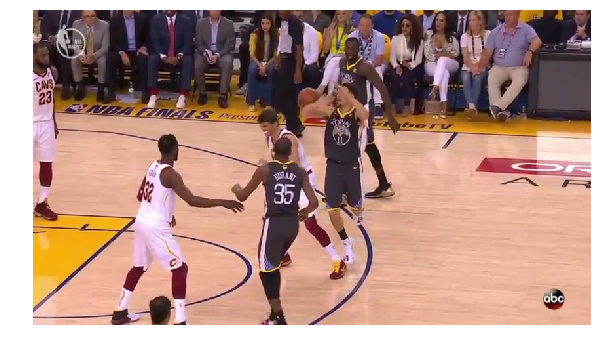

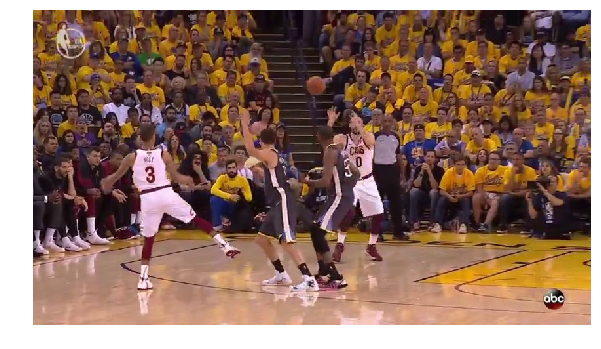

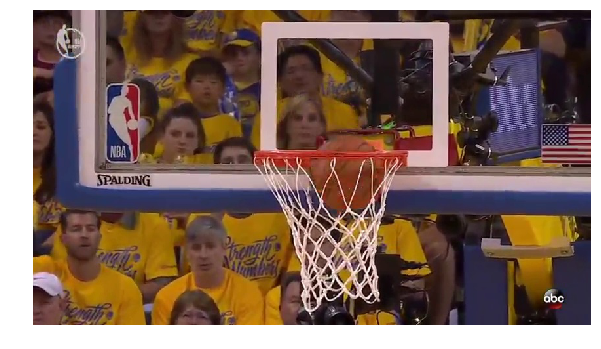

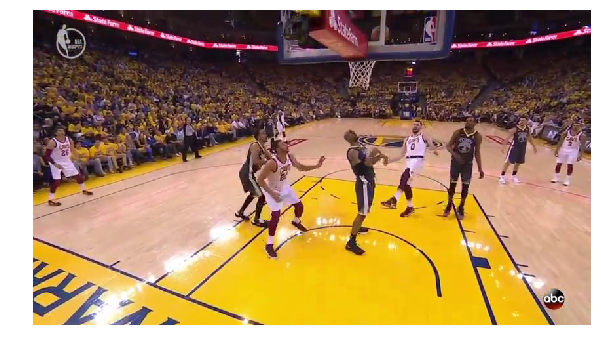

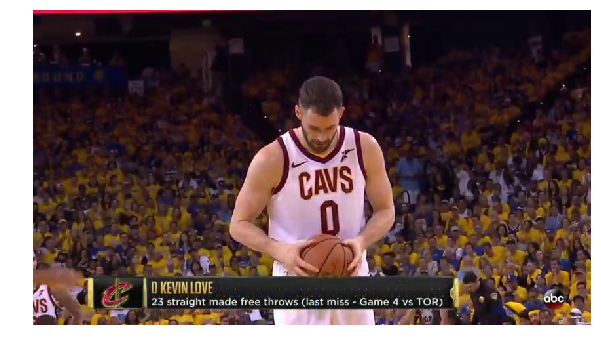

In [121]:
for i in hightlight:
    print(i)
    img = cv2.imread('frames/frame%d.jpg' %(i))
    ipynb_show_cv2_image(img, figsize=(10, 10))